In [25]:
import os

In [26]:
from io import StringIO

In [27]:
import numpy as np

In [28]:
import pandas as pd

In [29]:
os.getcwd()

'C:\\Users\\AKILAN M\\Leaf_extracted\\Data\\Leafdata3\\Leaf smut'

In [30]:
os.chdir(r"C:\Users\AKILAN M\Leaf_extracted\Data")

In [31]:
os.getcwd()

'C:\\Users\\AKILAN M\\Leaf_extracted\\Data'

In [32]:
os.listdir()

['Bacterial leaf blight-20200814T055237Z-001.zip',
 'Brown spot-20200814T055208Z-001.zip',
 'Leaf smut-20200814T055530Z-001.zip',
 'Leafdata1',
 'Leafdata2',
 'Leafdata3']

In [90]:
os.chdir(r"C:\Users\AKILAN M\Leaf_extracted\Data\Leafdata1\Bacterial leaf blight")

In [91]:
s = os.listdir()

In [35]:
def imgapp(s):
   h= [] 
   for i in s:
      h.append(s)
   return h

In [36]:
c = imgapp(s)

In [84]:
%matplotlib inline
import matplotlib.pyplot as plt

In [85]:
def img(n):
   ji = []
   for i in n:
      plt.imshow(i)
      plt.axis("off")
      o = plt.show()
      ji.append(o)
   return ji

In [86]:
import tensorflow as tf

In [87]:
def readimg(s):
    g = []
    for i in s:
        img = tf.io.read_file(i)
        img = tf.image.decode_jpeg(img.numpy(), channels=3)
        img = tf.convert_to_tensor(img)
        img = tf.image.resize(img,(224,224))
        img = img / 255
        g.append(img)
    return g

In [88]:
len(s)

40

In [92]:
Bacterial_leaf_blight_2 = readimg(s)

In [93]:
os.chdir(r"C:\Users\AKILAN M\Leaf_extracted\Data\Leafdata2\Brown spot")

In [94]:
t = os.listdir()

In [95]:
Brown_spot_2 = readimg(t)

In [100]:
len(Brown_spot_2)

40

In [96]:
os.chdir(r"C:\Users\AKILAN M\Leaf_extracted\Data\Leafdata3\Leaf smut")

In [97]:
u = os.listdir()

In [98]:
Leaf_smut_2 = readimg(u)

In [101]:
len(Leaf_smut_2)

40

In [102]:
def img(n):
   ji = []
   for i in n:
      plt.imshow(i)
      plt.axis("off")
      o = plt.show()
      ji.append(o)
   return ji

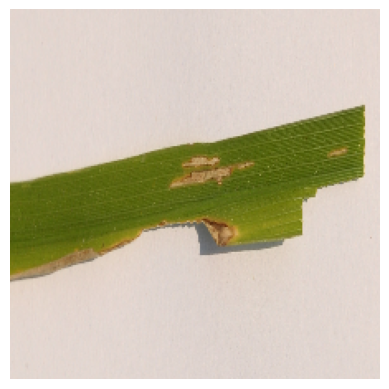

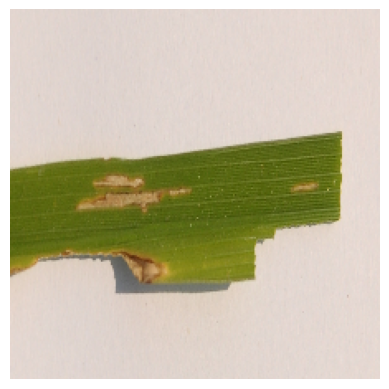

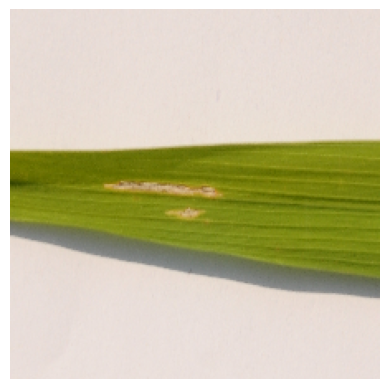

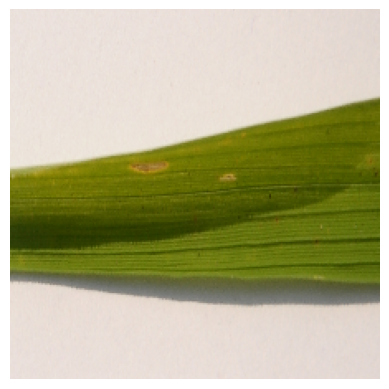

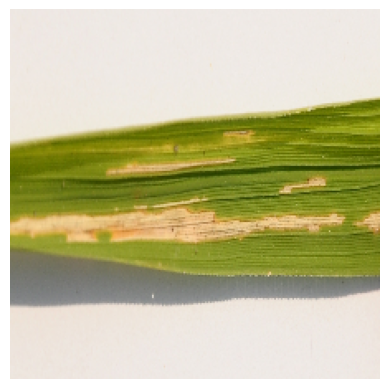

...

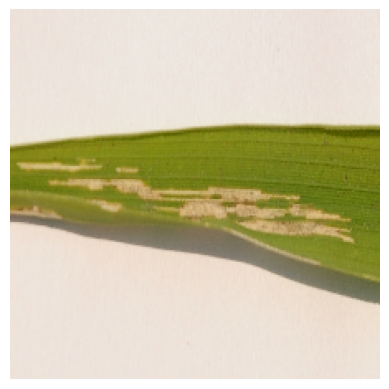

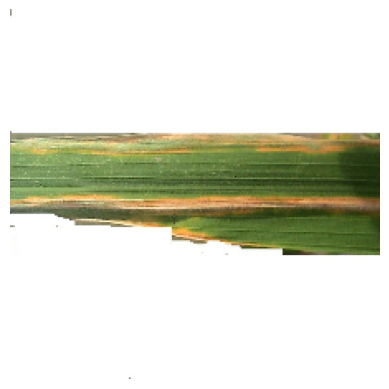

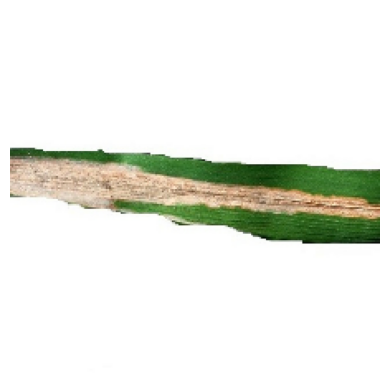

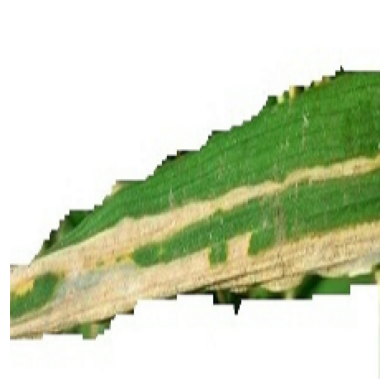

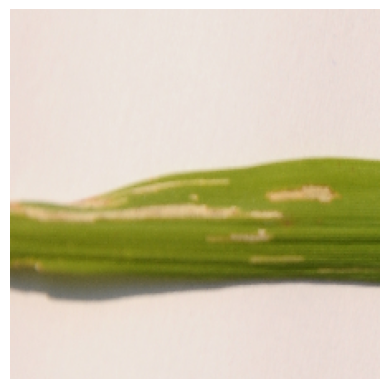

In [103]:
Bacterial_leaf_blight_3 = img(Bacterial_leaf_blight_2)

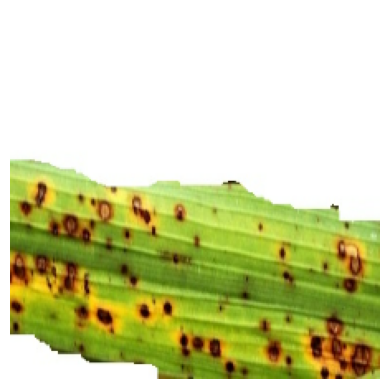

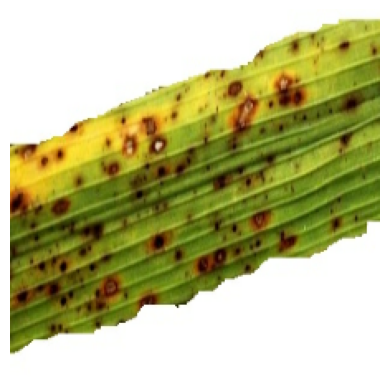

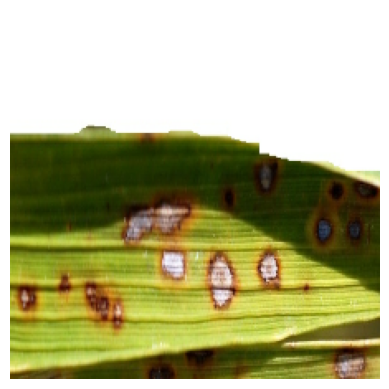

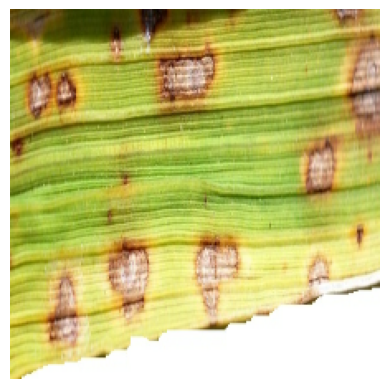

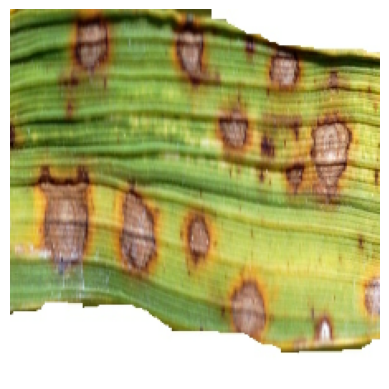

...

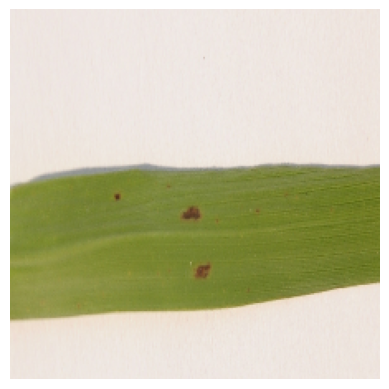

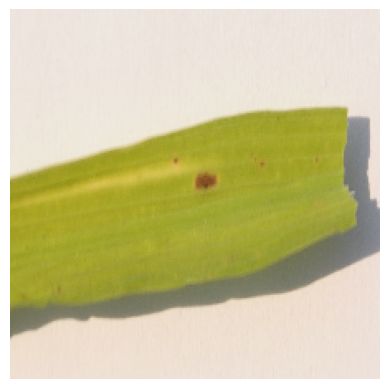

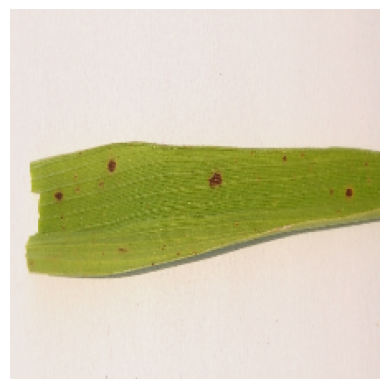

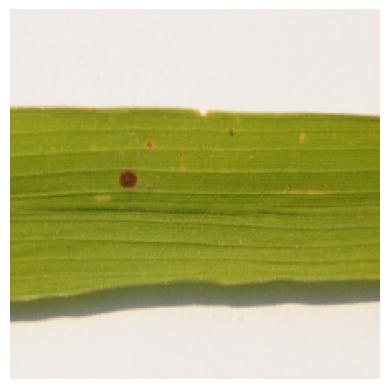

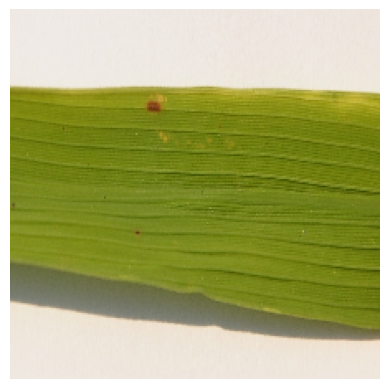

In [104]:
Brown_spot_3 = img(Brown_spot_2)

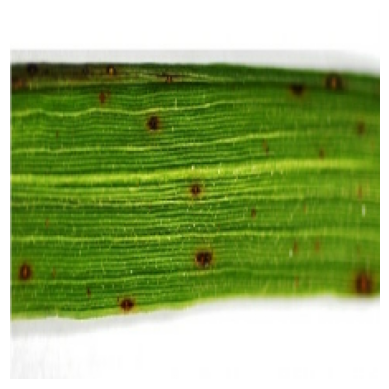

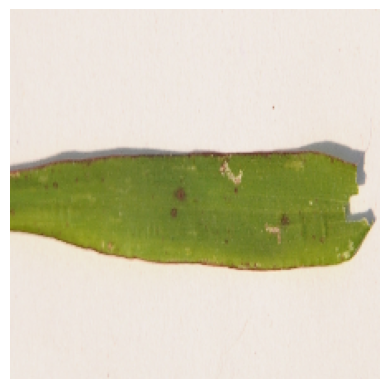

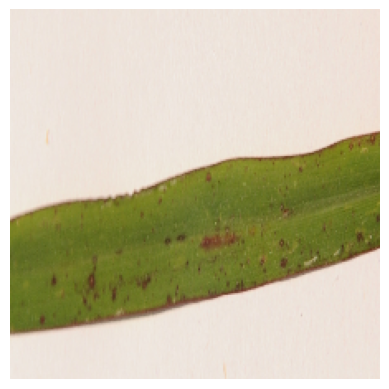

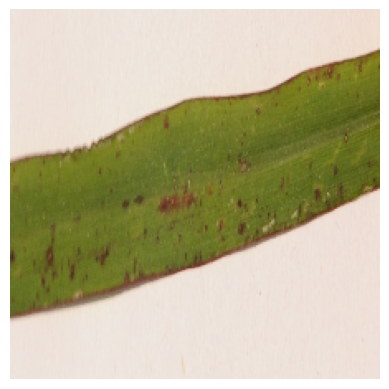

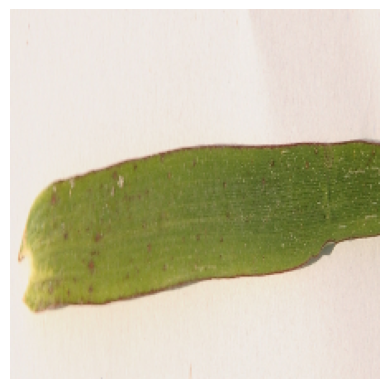

...

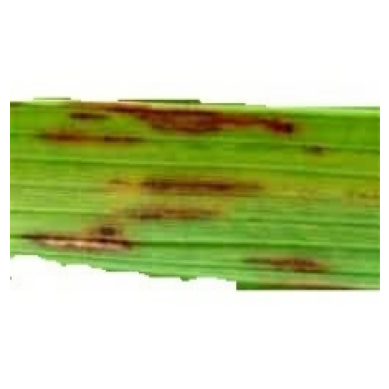

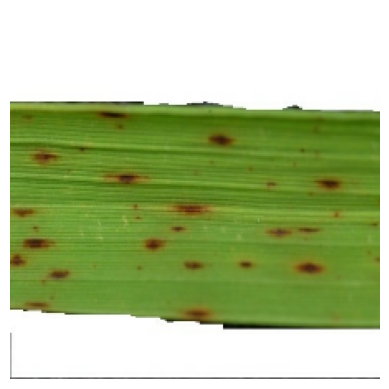

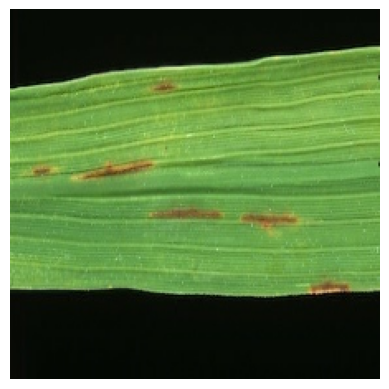

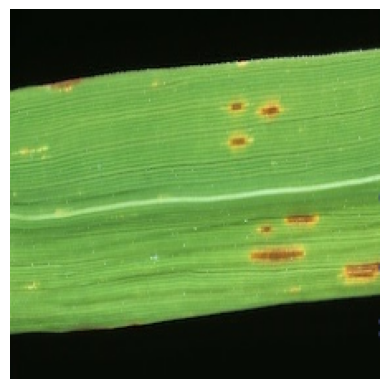

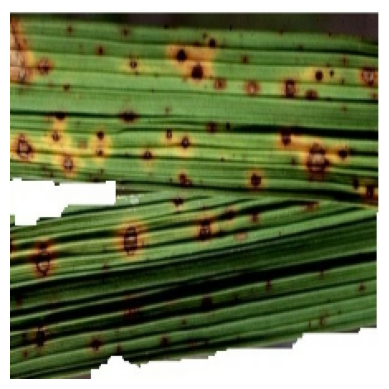

In [105]:
Leaf_smut_3 =img(Leaf_smut_2)

In [106]:
print(type(Bacterial_leaf_blight_3))

<class 'list'>


In [107]:
img_num_con = tf.concat([Bacterial_leaf_blight_2,Brown_spot_2,Leaf_smut_2],axis = 0)

In [108]:
tf.shape(img_num_con)

<tf.Tensor: shape=(4,), dtype=int32, numpy=array([120, 224, 224,   3], dtype=int32)>

In [109]:
Y_bact  = [0]*len(Bacterial_leaf_blight_2)
Y_brown = [1]*len(Brown_spot_2)
Y_smut  = [2]*len(Leaf_smut_2)

In [110]:
Y_lab = Y_bact+Y_brown+Y_smut

In [111]:
Y_lab =tf.convert_to_tensor(Y_lab)

In [112]:
tf.shape(img_num_con)

<tf.Tensor: shape=(4,), dtype=int32, numpy=array([120, 224, 224,   3], dtype=int32)>

In [113]:
tf.shape(Y_lab)

<tf.Tensor: shape=(1,), dtype=int32, numpy=array([120], dtype=int32)>

In [114]:
df =pd.DataFrame({"Image_numpy":list(img_num_con),"Y_label":list(Y_lab)}) 

In [115]:
df.head()

,Image_numpy,Y_label
0,"(((tf.Tensor(0.8965599, shape=(), dtype=float3...","tf.Tensor(0, shape=(), dtype=int32)"
1,"(((tf.Tensor(0.89385396, shape=(), dtype=float...","tf.Tensor(0, shape=(), dtype=int32)"
2,"(((tf.Tensor(0.911756, shape=(), dtype=float32...","tf.Tensor(0, shape=(), dtype=int32)"
3,"(((tf.Tensor(0.9223116, shape=(), dtype=float3...","tf.Tensor(0, shape=(), dtype=int32)"
4,"(((tf.Tensor(0.92941177, shape=(), dtype=float...","tf.Tensor(0, shape=(), dtype=int32)"


In [116]:
Images = tf.cast(img_num_con, tf.float32)
Y = tf.cast(Y_lab, tf.int32)


In [117]:
dataset = tf.data.Dataset.from_tensor_slices((Images,Y))

In [118]:
df1 = df =pd.DataFrame({"Image_numpy":list(Images),"Y_label":list(Y)}) 

In [119]:
dataset = dataset.shuffle(buffer_size=120 ,reshuffle_each_iteration=False)

In [120]:
for X,Y in dataset:
     print (X.shape, Y.numpy())

(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 0
(224, 22

In [121]:
dataset = dataset.repeat(10)

In [122]:
dataset

<_RepeatDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int32, name=None))>

In [123]:
for X,Y in dataset:
     print (X.shape, Y.numpy())

(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 2
(224, 224, 3) 2
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 1
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 0
(224, 224, 3) 0
(224, 22

In [124]:
len(dataset)

1200

In [125]:
N = len(dataset)

train_size = int(0.70*N)

val_size = int(0.20*N)

test_size = N - (train_size+ val_size)

In [126]:
X_train = dataset.take(train_size)

temp_ds  = dataset.skip(train_size)

X_val   = temp_ds.take(val_size)

X_test  = temp_ds.skip(val_size)


In [127]:
def XY_sizes():
      train = len(X_train) 
      val   = len(X_val) 
      test = len(X_test)
      print (f"The size of X_train and y_train are {train}")
      print (f"The size of X_val and y_val are {val}")
      print (f"The size of X_test and y_test are {test}")

In [128]:
XY_sizes()

The size of X_train and y_train are 840
The size of X_val and y_val are 240
The size of X_test and y_test are 120


In [129]:
def shap(u):
   for X,Y in u:
       print (X.shape, Y.numpy())

In [130]:
X_train = X_train.batch(32).prefetch(tf.data.AUTOTUNE)

In [131]:
shap(X_train)

(32, 224, 224, 3) [1 0 1 1 0 2 0 0 1 1 0 2 0 1 2 2 0 0 1 2 0 2 1 0 1 2 2 0 2 1 0 1]
(32, 224, 224, 3) [1 2 2 1 2 1 2 2 0 1 2 1 2 1 2 1 1 1 2 2 1 1 1 0 0 1 0 0 0 0 2 0]
(32, 224, 224, 3) [0 1 2 2 1 2 1 0 0 2 2 2 0 0 1 0 1 2 1 1 0 2 1 1 0 2 0 1 2 1 0 2]
(32, 224, 224, 3) [0 1 2 0 1 2 0 0 0 0 0 2 1 1 0 0 2 1 0 2 2 2 2 2 1 0 1 1 0 2 0 0]
(32, 224, 224, 3) [1 1 0 2 0 1 2 2 0 0 1 2 0 2 1 0 1 2 2 0 2 1 0 1 1 2 2 1 2 1 2 2]
(32, 224, 224, 3) [0 1 2 1 2 1 2 1 1 1 2 2 1 1 1 0 0 1 0 0 0 0 2 0 0 1 2 2 1 2 1 0]
(32, 224, 224, 3) [0 2 2 2 0 0 1 0 1 2 1 1 0 2 1 1 0 2 0 1 2 1 0 2 0 1 2 0 1 2 0 0]
(32, 224, 224, 3) [0 0 0 2 1 1 0 0 2 1 0 2 2 2 2 2 1 0 1 1 0 2 0 0 1 1 0 2 0 1 2 2]
(32, 224, 224, 3) [0 0 1 2 0 2 1 0 1 2 2 0 2 1 0 1 1 2 2 1 2 1 2 2 0 1 2 1 2 1 2 1]
(32, 224, 224, 3) [1 1 2 2 1 1 1 0 0 1 0 0 0 0 2 0 0 1 2 2 1 2 1 0 0 2 2 2 0 0 1 0]
(32, 224, 224, 3) [1 2 1 1 0 2 1 1 0 2 0 1 2 1 0 2 0 1 2 0 1 2 0 0 0 0 0 2 1 1 0 0]
(32, 224, 224, 3) [2 1 0 2 2 2 2 2 1 0 1 1 0 2 0 0 1 1 0 2 0 1 2 2 0 0 1 2 0

In [132]:
X_val = X_val.batch(32).prefetch(tf.data.AUTOTUNE)

In [133]:
shap(X_val)

(32, 224, 224, 3) [1 0 1 1 0 2 0 0 1 1 0 2 0 1 2 2 0 0 1 2 0 2 1 0 1 2 2 0 2 1 0 1]
(32, 224, 224, 3) [1 2 2 1 2 1 2 2 0 1 2 1 2 1 2 1 1 1 2 2 1 1 1 0 0 1 0 0 0 0 2 0]
(32, 224, 224, 3) [0 1 2 2 1 2 1 0 0 2 2 2 0 0 1 0 1 2 1 1 0 2 1 1 0 2 0 1 2 1 0 2]
(32, 224, 224, 3) [0 1 2 0 1 2 0 0 0 0 0 2 1 1 0 0 2 1 0 2 2 2 2 2 1 0 1 1 0 2 0 0]
(32, 224, 224, 3) [1 1 0 2 0 1 2 2 0 0 1 2 0 2 1 0 1 2 2 0 2 1 0 1 1 2 2 1 2 1 2 2]
(32, 224, 224, 3) [0 1 2 1 2 1 2 1 1 1 2 2 1 1 1 0 0 1 0 0 0 0 2 0 0 1 2 2 1 2 1 0]
(32, 224, 224, 3) [0 2 2 2 0 0 1 0 1 2 1 1 0 2 1 1 0 2 0 1 2 1 0 2 0 1 2 0 1 2 0 0]
(16, 224, 224, 3) [0 0 0 2 1 1 0 0 2 1 0 2 2 2 2 2]


In [134]:
X_test = X_test.batch(32).prefetch(tf.data.AUTOTUNE)

In [135]:
shap(X_test)

(32, 224, 224, 3) [1 0 1 1 0 2 0 0 1 1 0 2 0 1 2 2 0 0 1 2 0 2 1 0 1 2 2 0 2 1 0 1]
(32, 224, 224, 3) [1 2 2 1 2 1 2 2 0 1 2 1 2 1 2 1 1 1 2 2 1 1 1 0 0 1 0 0 0 0 2 0]
(32, 224, 224, 3) [0 1 2 2 1 2 1 0 0 2 2 2 0 0 1 0 1 2 1 1 0 2 1 1 0 2 0 1 2 1 0 2]
(24, 224, 224, 3) [0 1 2 0 1 2 0 0 0 0 0 2 1 1 0 0 2 1 0 2 2 2 2 2]


In [136]:
from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential

In [137]:
## Lasso Regularization##
l2_reg = tf.keras.regularizers.l2(0.001)

In [139]:
data_augumentation = tf.keras.Sequential([tf.keras.layers.RandomFlip("horizontal"),
                                          tf.keras.layers.RandomRotation(0.10),
                                          tf.keras.layers.RandomZoom(0.1),
                                          tf.keras.layers.RandomTranslation(0.05, 0.05),
                                          tf.keras.layers.RandomContrast(0.2)])

In [140]:
## Data Augumentation##
train_aug = X_train.map(lambda Images,Y : (data_augumentation(Images,training =True),Y), 
                        num_parallel_calls = tf.data.AUTOTUNE)

In [148]:
model2 = Sequential([
    tf.keras.Input(shape=(224, 224, 3)),
    tf.keras.layers.Conv2D(32, (3,3), padding="same", kernel_initializer="he_normal",
           kernel_regularizer=l2_reg),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation("relu"),


    tf.keras.layers.Conv2D(32, (3,3), padding="same", kernel_initializer="he_normal",
           kernel_regularizer=l2_reg),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation("relu"),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.MaxPooling2D((2,2)),


    tf.keras.layers.Conv2D(64, (3,3), padding="same", kernel_initializer="he_normal",
           kernel_regularizer=l2_reg),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation("relu"),
   

    tf.keras.layers.Conv2D(64, (3,3), padding="same", kernel_initializer="he_normal",
           kernel_regularizer=l2_reg),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation("relu"),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.MaxPooling2D((2,2)),

    tf.keras.layers.Conv2D(128, 3, padding="same", kernel_initializer="he_normal", kernel_regularizer=l2_reg),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation("relu"),

    tf.keras.layers.Conv2D(128, 3, padding="same", kernel_initializer="he_normal", kernel_regularizer=l2_reg),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation("relu"),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.MaxPooling2D(2,2),


    tf.keras.layers.GlobalAveragePooling2D(),

    tf.keras.layers.Dense(128, kernel_initializer="he_normal", kernel_regularizer=l2_reg),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation("relu"),
    tf.keras.layers.Dropout(0.5),

    tf.keras.layers.Dense(3, activation="softmax")
])

In [149]:
model2.compile(optimizer =tf.keras.optimizers.AdamW(1e-4),
               loss ="sparse_categorical_crossentropy",
               metrics=["accuracy"])

In [143]:
early_stop = tf.keras.callbacks.EarlyStopping(
    monitor="val_loss",
    patience=5,
    restore_best_weights=True)

In [144]:
checkpoint_cnn = tf.keras.callbacks.ModelCheckpoint(
    filepath="best_modelA2.keras",
    monitor="val_loss",
    save_best_only=True)

In [145]:
tensorboard_cnn = tf.keras.callbacks.TensorBoard(
    log_dir="logs2",
    histogram_freq=1)

In [146]:
os.chdir(r"C:\Users\AKILAN M\OneDrive\Desktop\val and train\2nd runleafcnn")

In [147]:
os.getcwd()

'C:\\Users\\AKILAN M\\OneDrive\\Desktop\\val and train\\2nd runleafcnn'

In [150]:
history1 = model2.fit(train_aug,
                      validation_data = X_val, 
                      epochs =50, 
                      callbacks=[checkpoint_cnn,early_stop,tensorboard_cnn])

Epoch 1/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 81s 3s/step - accuracy: 0.6083 - loss: 2.0337 - val_accuracy: 0.2583 - val_loss: 2.2629
Epoch 2/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 74s 3s/step - accuracy: 0.8000 - loss: 1.6893 - val_accuracy: 0.2833 - val_loss: 2.2658
Epoch 3/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 74s 3s/step - accuracy: 0.8571 - loss: 1.5317 - val_accuracy: 0.3000 - val_loss: 2.3089
Epoch 4/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 73s 3s/step - accuracy: 0.8917 - loss: 1.4685 - val_accuracy: 0.3083 - val_loss: 2.3322
Epoch 5/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 73s 3s/step - accuracy: 0.9107 - loss: 1.4164 - val_accuracy: 0.2000 - val_loss: 2.3841
Epoch 6/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 77s 3s/step - accuracy: 0.9250 - loss: 1.4082 - val_accuracy: 0.2833 - val_loss: 2.4805


In [152]:
base = tf.keras.applications.MobileNetV2(
    input_shape=(224,224,3),
    include_top=False,
    weights='imagenet'
)
base.trainable = False
model3 = Sequential([
    base,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(3, activation='softmax')
])


In [153]:
model3.compile(optimizer =tf.keras.optimizers.AdamW(1e-4),
               loss ="sparse_categorical_crossentropy",
               metrics=["accuracy"])

In [154]:
early_stop3 = tf.keras.callbacks.EarlyStopping(
    monitor="val_loss",
    patience=5,
    restore_best_weights=True)

In [155]:
checkpoint_cnn3 = tf.keras.callbacks.ModelCheckpoint(
    filepath="best_modelA2.keras",
    monitor="val_loss",
    save_best_only=True)

In [156]:
tensorboard_cnn3 = tf.keras.callbacks.TensorBoard(
    log_dir="logs3",
    histogram_freq=1)

In [157]:
history3 = model3.fit(train_aug,
                      validation_data = X_val, 
                      epochs =50, 
                      callbacks=[checkpoint_cnn3,early_stop3,tensorboard_cnn3])

Epoch 1/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 25s 652ms/step - accuracy: 0.5167 - loss: 1.0089 - val_accuracy: 0.7500 - val_loss: 0.6961
Epoch 2/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 18s 561ms/step - accuracy: 0.7667 - loss: 0.6127 - val_accuracy: 0.8083 - val_loss: 0.4921
Epoch 3/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 16s 558ms/step - accuracy: 0.8464 - loss: 0.4379 - val_accuracy: 0.8833 - val_loss: 0.3864
Epoch 4/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 17s 593ms/step - accuracy: 0.8774 - loss: 0.3614 - val_accuracy: 0.9167 - val_loss: 0.3102
Epoch 5/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 16s 574ms/step - accuracy: 0.9167 - loss: 0.2684 - val_accuracy: 0.9333 - val_loss: 0.2648
Epoch 6/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 16s 572ms/step - accuracy: 0.9393 - loss: 0.2194 - val_accuracy: 0.9417 - val_loss: 0.2287
Epoch 7/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 16s 550ms/step - accuracy: 0.9452 - loss: 0.2009 - val_accuracy: 0.9583 - val_loss: 0.1964
Epoch 8/50
27/27 ━━━━━━━━━━━━━━━━━━━━ 17s 594ms/step - accuracy: 0.9512 - loss: 0.1777 - val_accu

In [161]:
base.trainable = True

model3.compile(optimizer =tf.keras.optimizers.AdamW(1e-5),
               loss ="sparse_categorical_crossentropy",
               metrics=["accuracy"])

checkpoint_cnn4 = tf.keras.callbacks.ModelCheckpoint(
    filepath="best_model_effnet.keras",
    monitor="val_accuracy",
    save_best_only=True)

history4 = model3.fit(
    train_aug,validation_data=  X_val,
    epochs=10,
    callbacks=[early_stop3, checkpoint_cnn4 ]
)

Epoch 1/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 87s 2s/step - accuracy: 0.7643 - loss: 0.6000 - val_accuracy: 0.9917 - val_loss: 0.0261
Epoch 2/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 55s 2s/step - accuracy: 0.8881 - loss: 0.2885 - val_accuracy: 0.9917 - val_loss: 0.0381
Epoch 3/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9214 - loss: 0.2251 - val_accuracy: 0.9917 - val_loss: 0.0572
Epoch 4/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9488 - loss: 0.1480 - val_accuracy: 0.9750 - val_loss: 0.0663
Epoch 5/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.9560 - loss: 0.1332 - val_accuracy: 0.9417 - val_loss: 0.0921


In [162]:
best_model = tf.keras.models.load_model("best_model_effnet.keras")


In [164]:
best_model.evaluate(X_val)

8/8 ━━━━━━━━━━━━━━━━━━━━ 5s 309ms/step - accuracy: 0.9917 - loss: 0.0261


[0.026126693934202194, 0.9916666746139526]

In [165]:
model3.evaluate(X_val)

8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 324ms/step - accuracy: 0.9917 - loss: 0.0261


[0.026126693934202194, 0.9916666746139526]

In [166]:
model3.save("Leaf1_effnet_model.keras")


In [169]:
model3.summary()


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_2      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 3)              │           387 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,198,795 (27.46 MB)

 Trainable params: 2,388,227 (9.11 MB)

 Non-trainable params: 34,112 (133.25 KB)

 Optimizer params: 4,776,456 (18.22 MB)

In [170]:
prediction = model3.predict(X_val)

8/8 ━━━━━━━━━━━━━━━━━━━━ 5s 471ms/step


In [171]:
prediction

array([[6.16673497e-04, 9.84234154e-01, 1.51492329e-02],
       [9.99948859e-01, 2.34294293e-05, 2.76230185e-05],
       [4.17382216e-06, 9.99959350e-01, 3.64751140e-05],
       [8.40917055e-05, 9.88121986e-01, 1.17940027e-02],
       [9.99600828e-01, 3.84186336e-04, 1.49606085e-05],
       [2.65031540e-05, 1.51020021e-03, 9.98463273e-01],
       [9.99928117e-01, 6.59675279e-05, 5.99079158e-06],
       [9.99915719e-01, 7.68183454e-05, 7.56046347e-06],
       [9.63735487e-03, 9.88937378e-01, 1.42524159e-03],
       [1.25606235e-07, 9.99611914e-01, 3.88018379e-04],
       [9.99911070e-01, 8.79909057e-05, 1.00425052e-06],
       [2.88632640e-04, 2.98082475e-02, 9.69903171e-01],
       [9.99991059e-01, 3.85978001e-06, 5.16273076e-06],
       [4.72965548e-05, 9.99938846e-01, 1.38395671e-05],
       [5.92620427e-06, 3.69785726e-02, 9.63015437e-01],
       [8.50596174e-04, 2.38902797e-03, 9.96760309e-01],
       [9.99869704e-01, 1.29305394e-04, 9.31978207e-07],
       [9.99966979e-01, 2.64700

In [173]:
prediction.shape

(240, 3)

In [174]:
predict_labels = np.argmax(prediction, axis=1)

In [245]:
predict_labels

array([1, 0, 1, 1, 0, 2, 0, 0, 1, 1, 0, 2, 0, 1, 2, 2, 0, 0, 1, 2, 0, 2,
       1, 0, 1, 2, 2, 0, 2, 1, 0, 1, 1, 2, 2, 1, 2, 1, 2, 2, 0, 1, 2, 1,
       2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 1,
       2, 2, 1, 2, 1, 0, 0, 2, 2, 2, 0, 0, 1, 0, 1, 2, 1, 1, 0, 2, 1, 1,
       0, 2, 0, 1, 2, 1, 0, 2, 0, 1, 2, 0, 1, 2, 0, 0, 0, 0, 0, 2, 1, 1,
       0, 0, 2, 1, 0, 2, 0, 2, 2, 2, 1, 0, 1, 1, 0, 2, 0, 0, 1, 1, 0, 2,
       0, 1, 2, 2, 0, 0, 1, 2, 0, 2, 1, 0, 1, 2, 2, 0, 2, 1, 0, 1, 1, 2,
       2, 1, 2, 1, 2, 2, 0, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 0,
       0, 1, 0, 0, 0, 0, 2, 0, 0, 1, 2, 2, 1, 2, 1, 0, 0, 2, 2, 2, 0, 0,
       1, 0, 1, 2, 1, 1, 0, 2, 1, 1, 0, 2, 0, 1, 2, 1, 0, 2, 0, 1, 2, 0,
       1, 2, 0, 0, 0, 0, 0, 2, 1, 1, 0, 0, 2, 1, 0, 2, 0, 2, 2, 2])

In [186]:
realval_labels = [Y.numpy() for X,Y  in X_val]

In [190]:
realval_labels = np.concatenate(realval_labels).tolist()

In [193]:
realval_labels = np.array(realval_labels)

In [194]:
realval_labels

array([1, 0, 1, 1, 0, 2, 0, 0, 1, 1, 0, 2, 0, 1, 2, 2, 0, 0, 1, 2, 0, 2,
       1, 0, 1, 2, 2, 0, 2, 1, 0, 1, 1, 2, 2, 1, 2, 1, 2, 2, 0, 1, 2, 1,
       2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 1,
       2, 2, 1, 2, 1, 0, 0, 2, 2, 2, 0, 0, 1, 0, 1, 2, 1, 1, 0, 2, 1, 1,
       0, 2, 0, 1, 2, 1, 0, 2, 0, 1, 2, 0, 1, 2, 0, 0, 0, 0, 0, 2, 1, 1,
       0, 0, 2, 1, 0, 2, 2, 2, 2, 2, 1, 0, 1, 1, 0, 2, 0, 0, 1, 1, 0, 2,
       0, 1, 2, 2, 0, 0, 1, 2, 0, 2, 1, 0, 1, 2, 2, 0, 2, 1, 0, 1, 1, 2,
       2, 1, 2, 1, 2, 2, 0, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 0,
       0, 1, 0, 0, 0, 0, 2, 0, 0, 1, 2, 2, 1, 2, 1, 0, 0, 2, 2, 2, 0, 0,
       1, 0, 1, 2, 1, 1, 0, 2, 1, 1, 0, 2, 0, 1, 2, 1, 0, 2, 0, 1, 2, 0,
       1, 2, 0, 0, 0, 0, 0, 2, 1, 1, 0, 0, 2, 1, 0, 2, 2, 2, 2, 2])

In [195]:
man_accuracy = np.mean(realval_labels == predict_labels)

In [197]:
man_accuracy*100

np.float64(99.16666666666667)

In [201]:
model3.save_weights("Leaf_model3s.weights.h5")

In [235]:
test_image = X_test.map(lambda Images,Y : Images) 

In [231]:

def test(X_test):
       processed_images = []

       for X in X_test:         
              img = tf.image.resize(X, (224,224)) 
              img = tf.cast(img, tf.float32) / 255.0   
              processed_images.append(img)

       test_img = np.array(processed_images, dtype=np.float32)


In [241]:
test_image 

<_MapDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [242]:
for batch in test_image.take(1):
    print(batch.shape)


(32, 224, 224, 3)


In [243]:
test_predict = model3.predict(test_image )

4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 850ms/step


In [244]:
test_predict

array([[6.16673497e-04, 9.84234154e-01, 1.51492329e-02],
       [9.99948859e-01, 2.34294293e-05, 2.76230185e-05],
       [4.17382216e-06, 9.99959350e-01, 3.64751140e-05],
       [8.40917055e-05, 9.88121986e-01, 1.17940027e-02],
       [9.99600828e-01, 3.84186336e-04, 1.49606085e-05],
       [2.65031540e-05, 1.51020021e-03, 9.98463273e-01],
       [9.99928117e-01, 6.59675279e-05, 5.99079158e-06],
       [9.99915719e-01, 7.68183454e-05, 7.56046347e-06],
       [9.63735487e-03, 9.88937378e-01, 1.42524159e-03],
       [1.25606235e-07, 9.99611914e-01, 3.88018379e-04],
       [9.99911070e-01, 8.79909057e-05, 1.00425052e-06],
       [2.88632640e-04, 2.98082475e-02, 9.69903171e-01],
       [9.99991059e-01, 3.85978001e-06, 5.16273076e-06],
       [4.72965548e-05, 9.99938846e-01, 1.38395671e-05],
       [5.92620427e-06, 3.69785726e-02, 9.63015437e-01],
       [8.50596174e-04, 2.38902797e-03, 9.96760309e-01],
       [9.99869704e-01, 1.29305394e-04, 9.31978207e-07],
       [9.99966979e-01, 2.64700

In [246]:
test_predict_labels = np.argmax(test_predict,axis=1)

In [247]:
test_predict_labels

array([1, 0, 1, 1, 0, 2, 0, 0, 1, 1, 0, 2, 0, 1, 2, 2, 0, 0, 1, 2, 0, 2,
       1, 0, 1, 2, 2, 0, 2, 1, 0, 1, 1, 2, 2, 1, 2, 1, 2, 2, 0, 1, 2, 1,
       2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 1,
       2, 2, 1, 2, 1, 0, 0, 2, 2, 2, 0, 0, 1, 0, 1, 2, 1, 1, 0, 2, 1, 1,
       0, 2, 0, 1, 2, 1, 0, 2, 0, 1, 2, 0, 1, 2, 0, 0, 0, 0, 0, 2, 1, 1,
       0, 0, 2, 1, 0, 2, 0, 2, 2, 2])

In [248]:
test_lab1 = X_test.map(lambda Images,Y : Y) 

In [256]:
test_lab1 = [Y.numpy() for Y in test_lab1]

In [257]:
test_lab1

[array([1, 0, 1, 1, 0, 2, 0, 0, 1, 1, 0, 2, 0, 1, 2, 2, 0, 0, 1, 2, 0, 2,
        1, 0, 1, 2, 2, 0, 2, 1, 0, 1], dtype=int32),
 array([1, 2, 2, 1, 2, 1, 2, 2, 0, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1,
        1, 0, 0, 1, 0, 0, 0, 0, 2, 0], dtype=int32),
 array([0, 1, 2, 2, 1, 2, 1, 0, 0, 2, 2, 2, 0, 0, 1, 0, 1, 2, 1, 1, 0, 2,
        1, 1, 0, 2, 0, 1, 2, 1, 0, 2], dtype=int32),
 array([0, 1, 2, 0, 1, 2, 0, 0, 0, 0, 0, 2, 1, 1, 0, 0, 2, 1, 0, 2, 2, 2,
        2, 2], dtype=int32)]

In [258]:
test_lab1= np.concatenate(test_lab1).tolist()

In [260]:
test_lab1 = np.array(test_lab1)

In [261]:
test_lab1

array([1, 0, 1, 1, 0, 2, 0, 0, 1, 1, 0, 2, 0, 1, 2, 2, 0, 0, 1, 2, 0, 2,
       1, 0, 1, 2, 2, 0, 2, 1, 0, 1, 1, 2, 2, 1, 2, 1, 2, 2, 0, 1, 2, 1,
       2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 1,
       2, 2, 1, 2, 1, 0, 0, 2, 2, 2, 0, 0, 1, 0, 1, 2, 1, 1, 0, 2, 1, 1,
       0, 2, 0, 1, 2, 1, 0, 2, 0, 1, 2, 0, 1, 2, 0, 0, 0, 0, 0, 2, 1, 1,
       0, 0, 2, 1, 0, 2, 2, 2, 2, 2])

In [262]:
test_accuracy = np.mean(test_lab1 == test_predict_labels)

In [264]:
test_accuracy*100

np.float64(99.16666666666667)

In [291]:
clas_name= ["Bacterial_leaf_blight","Brown_spot","Brown_spot"]

In [283]:
def predictor(img_path):
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img,(224,224))
        img = img / 255
        img = tf.expand_dims(img, axis=0)
        c = model3.predict(img)
        d = np.argmax(c, axis =1)[0]
        e = clas_name[d]
        print(f"The Image depicts {e} Disease")
        
         

In [278]:
os.chdir(r"C:\Users\AKILAN M\Leaf_extracted\Data\Leafdata1\Bacterial leaf blight")

In [279]:
img_list = os.listdir(r"C:\Users\AKILAN M\Leaf_extracted\Data\Leafdata1\Bacterial leaf blight")

In [280]:
img_list[0]

'DSC_0365.JPG'

In [284]:
predictor(r"C:\Users\AKILAN M\Leaf_extracted\Data\Leafdata1\Bacterial leaf blight\DSC_0365.JPG")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
The Image depicts Bacterial_leaf_blight Disease


In [285]:
os.chdir(r"C:\Users\AKILAN M\Leaf_extracted\Data\Leafdata2\Brown spot")


In [287]:
hl = os.listdir()

In [292]:
predictor(hl[2])

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
The Image depicts Brown_spot Disease


In [293]:
import pickle

In [295]:
model = model3

with open("Leaf1_model.pkl", "wb") as f:
    pickle.dump(model, f)
